### making an edge plot

In [1]:
%load_ext autoreload
%autoreload 2
%cd -q ../test/

In [2]:
import matplotlib
#matplotlib.rcParams.update({'font.size': 18, 'font.family': 'STIXGeneral', 'mathtext.fontset': 'stix'})
matplotlib.rcParams.update({'text.usetex': True})
%matplotlib inline
%config InlineBackend.figure_format='svg'
import matplotlib.pyplot as plt

We will code some example images getting sparse codes, then reconstructing images with the overlaid edges:

In [3]:
%%writefile experiment_duck.py
# -*- coding: utf8 -*-
from __future__ import division, print_function

tag = 'example_'

import os
import numpy as np
from SparseEdges import SparseEdges
#ef = SparseEdges('https://raw.githubusercontent.com/bicv/SparseEdges/master/default_param.py')
mp = SparseEdges('../notebooks/srep_param.py')


import numpy as np
np.set_printoptions(precision=4)#, suppress=True)

for filename in ['elephant.jpg', 'bird.jpg']:#'zebra.jpg', 'duck.jpg', 'duck2.jpg', , 'seagull.jpg']:
    print ('Processing ', filename)
    # defining input image
    image = mp.imread('../database/' + filename)

    mp.pe.N = 2048
    mp.set_size(image)
    
    white = mp.pipeline(image, do_whitening=True)

    locked = False
    matname = os.path.join(mp.pe.matpath, tag + filename + '.npy')

    try:
        edges = np.load(matname)
    except Exception:
        if not os.path.isfile(matname + '_lock'):
            open(matname + '_lock', 'w').close()
            print('Doing ' + matname)
            edges, C_res = mp.run_mp(white, verbose=True)
            print(edges.shape)
            np.save(matname, edges)    
            os.remove(matname + '_lock')
        else:
            print('locked ' + matname)
            locked = True

    if not locked:
        matname = os.path.join(mp.pe.matpath, tag + filename + '_RMSE.npy')
        try:
            RMSE = np.load(matname)
        except Exception:
            if not os.path.isfile(matname + '_lock'):
                open(matname + '_lock', 'w').close()
                print('Doing ' + matname)

                RMSE = np.ones(mp.pe.N)
                image_rec = np.zeros_like(image)
                for i_N in range(mp.pe.N):
                    image_rec += mp.reconstruct(edges[:, i_N][:, np.newaxis])
                    RMSE[i_N] =  ((white-image_rec)**2).sum()

                np.save(matname, RMSE)  
                os.remove(matname + '_lock')
            else:
                print('locked ' + matname)
                locked = True
            
    if not locked:
        image_rec = mp.reconstruct(edges)
        if mp.pe.do_whitening: 
            print('Dewhitening')
            image_rec = mp.dewhitening(image_rec)
            
        image_rec = mp.normalize(image_rec, center=True)
        
        print (edges.shape, edges.max(axis=-1), edges.min(axis=-1))

        mp.pe.figsize_edges = 9 # .382 * fig_width
        mp.pe.line_width = .7
        mp.pe.scale = 1.5
        C = .4
        opts = dict(v_min=-1./C, v_max=1./C,  color='brown', show_phase=False, gamma=1.)#, pedestal=.0, gamma=.3
        
        fig, a = mp.show_edges(edges, image=image_rec, **opts) 
        mp.savefig(fig, tag + filename.replace('.', '_'), figpath=None)
            
        if True:
            C = 1.
            fig, a = mp.show_edges(edges, image=image*1., **opts) 
            mp.savefig(fig, tag + filename.replace('.', '_') + '_edge', figpath=None)

            fig, a = mp.show_edges(edges, image=image_rec*1., **opts) 
            mp.savefig(fig, tag + filename.replace('.', '_') + '_rec', figpath=None)


Overwriting experiment_duck.py


In [4]:
!find . -name  .*example_.*

In [5]:
%run experiment_duck.py

Processing  elephant.jpg
Dewhitening
(6, 2048) [5.9500e+02 9.0900e+02 1.5708e+00 6.1805e-01 4.3540e+00 3.1402e+00] [ 0.      0.     -1.4399  0.0344  0.7464 -3.141 ]
Processing  bird.jpg
Dewhitening
(6, 2048) [5.9500e+02 8.9300e+02 1.5708e+00 6.1805e-01 3.0347e+00 3.1381e+00] [ 0.      0.     -1.4399  0.0081  0.2894 -3.1413]


In [6]:
edges = np.load('./cache_dir/example_elephant.jpg.npy')

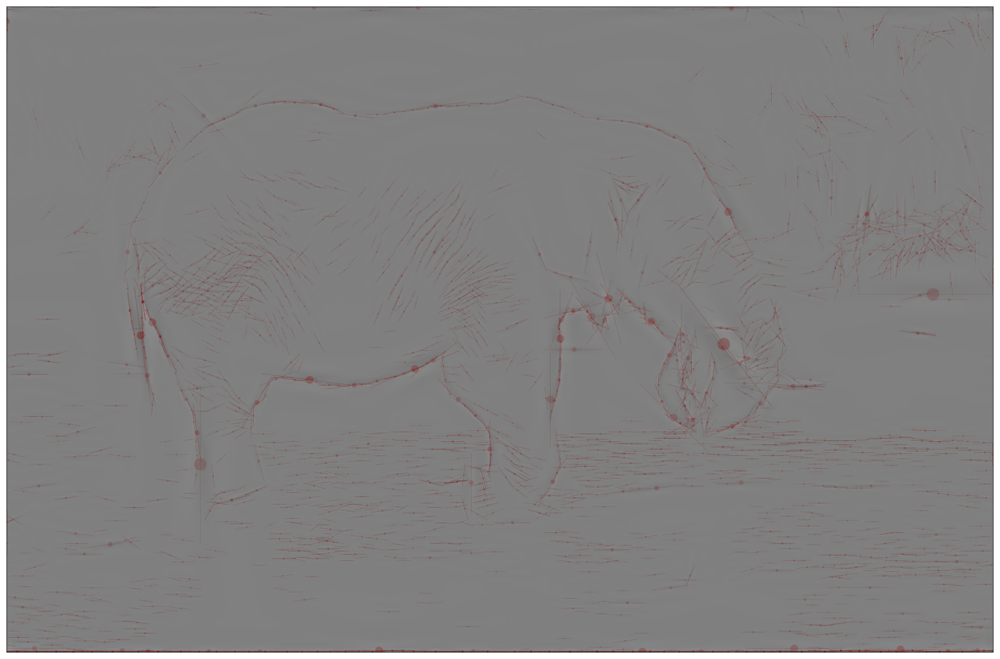

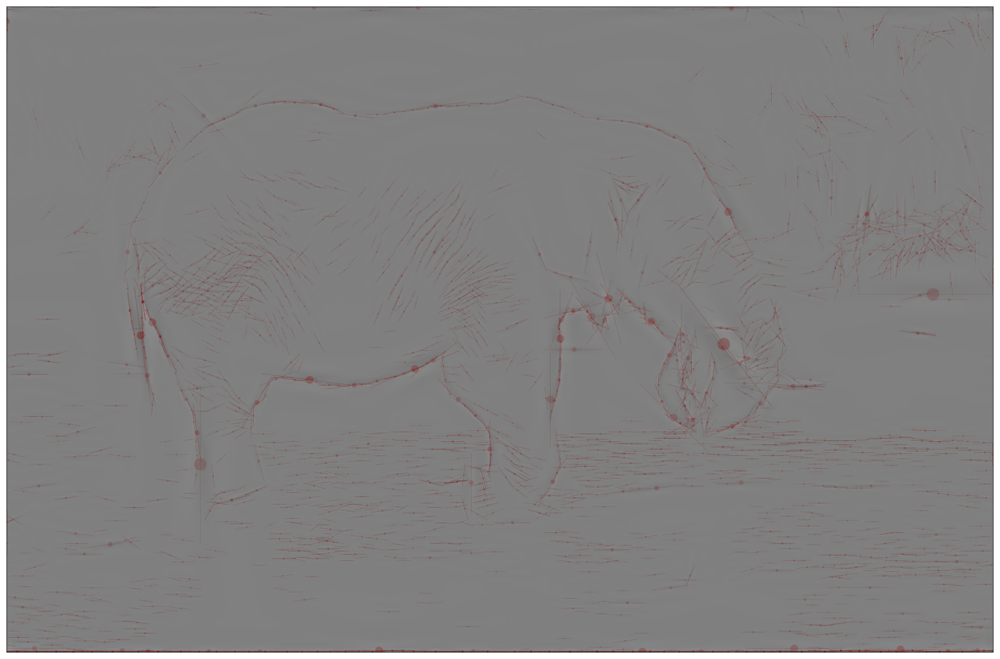

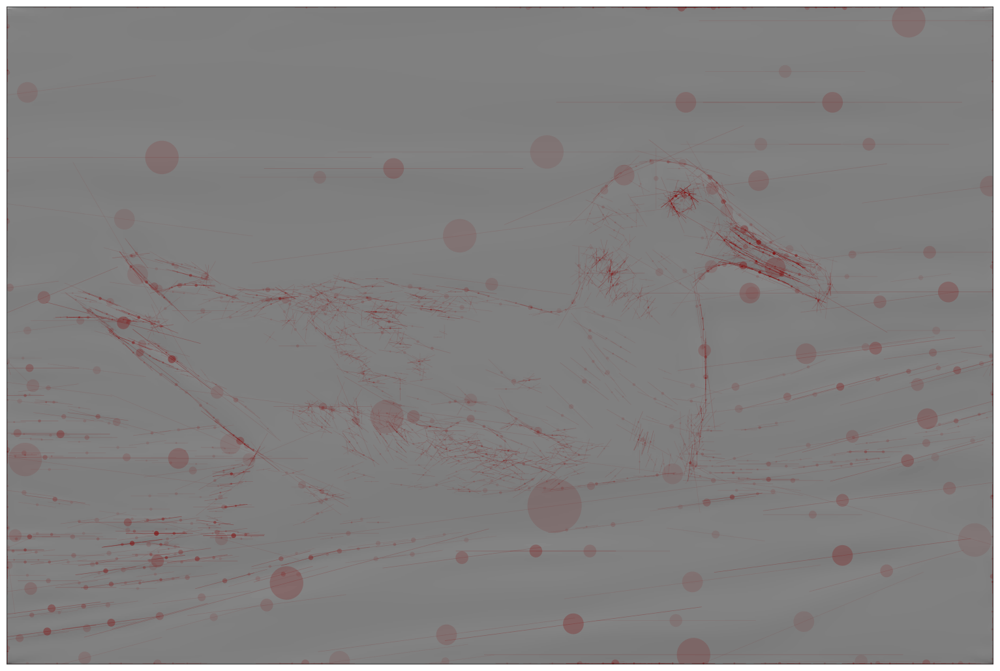

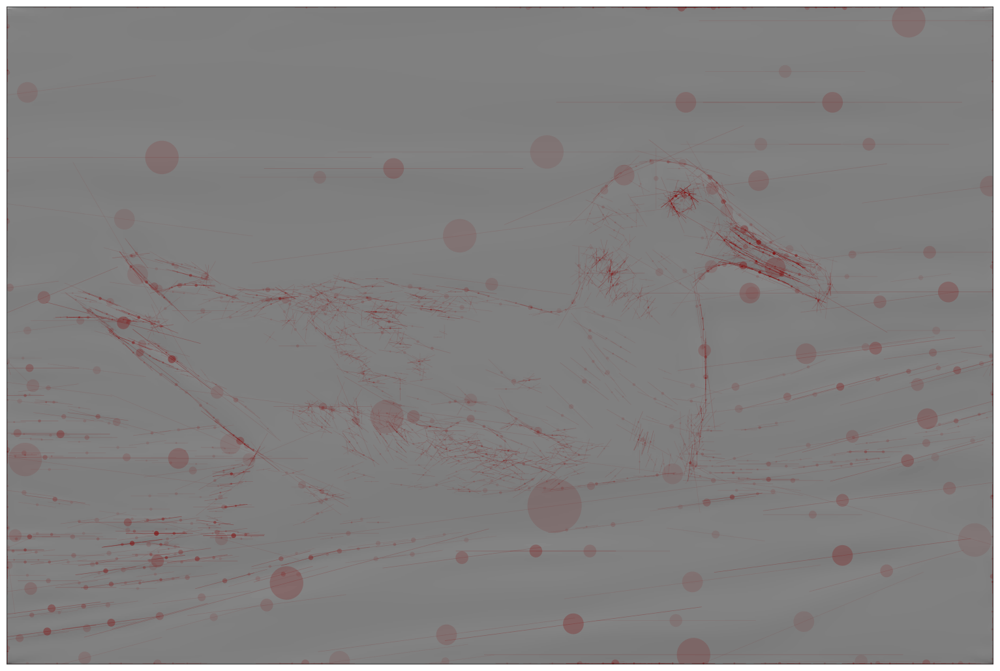

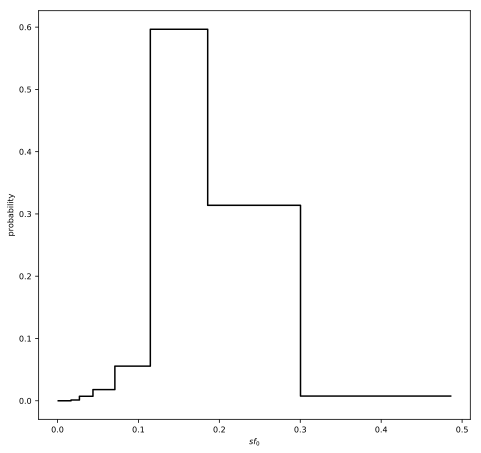

In [7]:
fig, ax = mp.histedges_scale(edges)

In [8]:
print (mp.binedges_sf_0, mp.binedges_loglevel, mp.sf_0)
mp.histedges_scale(edges, display=False)

[0.0009 0.0015 0.0024 0.004  0.0064 0.0103 0.0167 0.0271 0.0438 0.0709
 0.1147 0.1856 0.3003 0.4859 0.7862] [-7.  -4.2 -1.4  1.4  4.2  7. ] [0.4643 0.297  0.19   0.1215 0.0777 0.0497 0.0318 0.0203 0.013  0.0083
 0.0053 0.0034 0.0022 0.0014]


(array([0.    , 0.    , 0.    , 0.    , 0.    , 0.    , 0.    , 0.0012,
        0.0072, 0.0179, 0.0556, 0.5965, 0.3138, 0.0076]),
 array([0.0009, 0.0015, 0.0024, 0.004 , 0.0064, 0.0103, 0.0167, 0.0271,
        0.0438, 0.0709, 0.1147, 0.1856, 0.3003, 0.4859, 0.7862]))

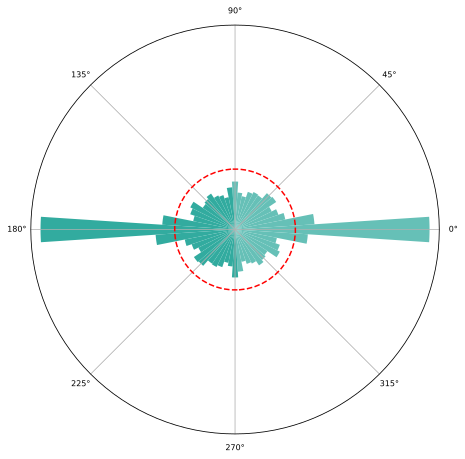

In [9]:
fig, ax = mp.histedges_theta(edges)

In [10]:
from IPython.display import display, Image

for figtype in ['', '_edge', '_rec']:
    for filename in ['elephant.jpg', 'bird.jpg']:#'zebra.jpg', 'duck.jpg', 'duck2.jpg', , 'seagull.jpg']:
        try: display(Image(filename='./results/example_' + filename.replace('.', '_') + figtype + '.png'))
        except Exception as e: print(e)

## Schematics for edge co-occurences and  second-order statistics

In [11]:
import tikzmagic

In [12]:
%load_ext tikzmagic

In [13]:
%%tikz -p tkz-euclide -x \usetkzobj{{all}} --scale 15 -f pdf -S ../figures/diagram.pdf

\begin{scope}[scale=5/13]
%\fill[white,fill opacity=.9] (0, 1.2) rectangle (13, 8);
%\tkzInit[xmax=13, ymax=8]

%----------------------------------------------------------
% Defining coordinates
%----------------------------------------------------------

\tkzDefPoint(2.95, 2.25){A}
\tkzLabelPoints[above left](A)
\tkzDefPoint(10.95, 5.3){B} % HACK
\tkzLabelPoints[above==3pt](B){$o$} % HACK
\tkzDefPoint(11,5.25){B}
\tkzDefPoint(10, 2.25){C}

% draw red dots at the center of edges
\tkzDrawPoints[size=10, color=red, fill=red](A,B)

%----------------------------------------------------------
% Drawing the lines and segments
%----------------------------------------------------------
\tkzDrawLine[color=red,line width=2pt, add=-1.15 and -.15 ](C,A)
\tkzDrawLine[color=red,line width=2pt, add=-1.3 and -.3 ](C,B)

\tkzDrawLine(A,B)
\tkzDrawLines[dashed](A,C B,C)

% drawing arcs for angles  
\tkzMarkAngle[size=2.5,mkpos=.2](C,A,B)
\tkzLabelAngle[pos=3.5,circle](C,A,B){$\mathsf{\phi}$}

\tkzDefPointWith[linear,K=1.5](A,C)
\tkzGetPoint{D}
\tkzDefPointWith[linear,K=.75](B,C)
\tkzGetPoint{E}
\tkzMarkAngle[size=1,mkpos=.2](D,C,E)
\tkzLabelAngle[pos=1.75,circle](D,C,E){$\mathsf{\theta}$}

%----------------------------------------------------------
% Drawing normals
%----------------------------------------------------------

\tkzDefLine[perpendicular=through A, K=-.75](C,A)
\tkzGetPoint{a1}
\tkzDefLine[perpendicular=through B, K=2.5](C,B)
\tkzGetPoint{b1}
\tkzInterLL(a1,A)(b1,B)  \tkzGetPoint{H}
\tkzMarkRightAngle[size=.5](H,A,C)
\tkzMarkRightAngle[size=.5](H,B,C)
\tkzDrawLines[dashed,dash phase=1.5pt](a1,A)
\tkzDrawLines[dashed,dash phase=0.5pt](b1,B)

%----------------------------------------------------------
% Drawing mediator and psi line
%----------------------------------------------------------
%    \tkzDefLine[mediator](A,B)          \tkzGetPoints{m1}{M}
\tkzDefMidPoint(A,B)
\tkzGetPoint{M}
\tkzDefLine[perpendicular=through M, K=.4](A,B)
\tkzGetPoint{m1}
\tkzMarkRightAngle[size=.5](B,M,m1)    

\tkzFillAngle[size=1.4,fill=blue!40](m1,M,H)
\tkzLabelAngle[pos=2,circle](m1,M,H){$\mathsf{\psi}$}%= \phi -\theta/2
\tkzDrawLines[](m1,M M,H)    

\pgfresetboundingbox
\path(1, 1) rectangle (13, 9);
\end{scope}

## Montage of the 2 subplots

In [14]:
#!cp ./results/example_elephant_jpg_rec.png ../figures/figure_elephant_jpg.png
!cp ./results/example_elephant_jpg_edge.png ../figures/figure_elephant_jpg.png

In [15]:
!cp ../figures/figure_elephant_jpg.png /tmp
!cp ../figures/diagram.pdf /tmp

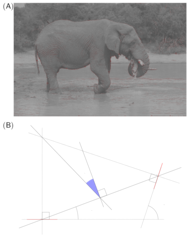

In [16]:
%%tikz  -S ../figures/figure_model.pdf

\draw [anchor=north west] (0, 10.5) node {\includegraphics[width=8cm]{/tmp/figure_elephant_jpg.png}};
\draw [anchor=north west] (0, 5) node {\includegraphics[width=8cm]{/tmp/diagram.pdf}};
\draw [anchor=north west,fill=white] (-.5, 10.5) node {$\mathsf{(A)}$};
\draw [anchor=north west,fill=white] (-.5, 5) node {$\mathsf{(B)}$};


In [17]:
%ls ../figures/figure_elep*

../figures/figure_elephant_jpg.png


In [18]:
!convert  ../figures/figure_model.pdf  ../figures/figure_model.jpg

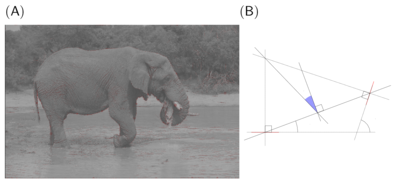

In [19]:
%%tikz  -S ../figures/figure_model_ls.pdf

\begin{scope}[xscale=1,xshift=0cm]
\draw [anchor=north west] (0, 5) node {\includegraphics[width=6cm]{/tmp/figure_elephant_jpg.png}};
\end{scope}
\draw [anchor=north west] (6, 4.5) node {\includegraphics[width=4cm]{/tmp/diagram.pdf}};
\draw [anchor=north west,fill=white] (0, 5.5) node {$\mathsf{(A)}$};
\draw [anchor=north west,fill=white] (6, 5.5) node {$\mathsf{(B)}$};


In [20]:
!convert  ../figures/figure_model_ls.pdf  ../figures/figure_model_ls.jpg

In [21]:
from IPython.display import display, Image

for figtype in ['', '_ls']:
    try: display(Image(filename='../figures/figure_model' + figtype + '.png'))
    except Exception: pass

## version control

In [22]:
!git status

On branch master
Your branch is up to date with 'origin/master'.

Changes not staged for commit:
  (use "git add <file>..." to update what will be committed)
  (use "git checkout -- <file>..." to discard changes in working directory)

	modified:   ../figures/MPtutorial.jpg
	modified:   ../figures/MPtutorial.pdf
	modified:   ../figures/MPtutorial.png
	modified:   ../figures/MPtutorial_rec.jpg
	modified:   ../figures/MPtutorial_rec.pdf
	modified:   ../figures/MPtutorial_rec.png
	modified:   ../figures/diagram.pdf
	modified:   ../figures/figure_chevrons_animals.jpg
	modified:   ../figures/figure_chevrons_animals.pdf
	modified:   ../figures/figure_chevrons_animals.png
	modified:   ../figures/figure_chevrons_animals_FR.jpg
	modified:   ../figures/figure_chevrons_animals_FR.pdf
	modified:   ../figures/figure_chevrons_animals_FR.png
	modified:   ../figures/figure_elephant_jpg.png
	modified:   ../figures/figure_model.pdf
	modified:   ../figures/figure_model_ls.jpg
	modified:   ../figures/figur

In [24]:
!git commit -m' figure model ' ../notebooks/2* ../figures/figure_model.* ../figures/diagram.* ; git push

[master 1808d6b]  figure model
 1 file changed, 24739 insertions(+), 24740 deletions(-)
Enumerating objects: 7, done.
Counting objects: 100% (7/7), done.
Delta compression using up to 36 threads.
Compressing objects: 100% (4/4), done.
Writing objects: 100% (4/4), 167.56 KiB | 80.00 KiB/s, done.
Total 4 (delta 3), reused 0 (delta 0)
remote: Resolving deltas: 100% (3/3), completed with 3 local objects.
To https://github.com/laurentperrinet/PerrinetBednar15
   0835cd5..1808d6b  master -> master
